## TSNE Grid로 MNIST 분석

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
from matplotlib import offsetbox, patheffects
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.spatial.distance import cdist
from sklearn.datasets import fetch_openml
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.utils import shuffle
from sklearn.preprocessing import minmax_scale
from lapjv import lapjv
from PIL import Image

rc = {
  'font.family': ['sans-serif'],
  'font.sans-serif': ['Open Sans', 'Arial Unicode MS'],
  'font.size': 12,
  'figure.figsize': (8, 6),
  'grid.linewidth': 0.5,
  'legend.fontsize': 10,
  'legend.frameon': True,
  'legend.framealpha': 0.6,
  'legend.handletextpad': 0.2,
  'lines.linewidth': 1,
  'axes.facecolor': '#fafafa',
  'axes.labelsize': 10,
  'axes.titlesize': 14,
  'axes.linewidth': 0.5,
  'xtick.labelsize': 10,
  'xtick.minor.visible': True,
  'ytick.labelsize': 10,
  'figure.titlesize': 14
}
sns.set('notebook', 'whitegrid', rc=rc)

def colorize(d, color, alpha=1.0):
  rgb = np.dstack((d,d,d)) * color
  return np.dstack((rgb, d * alpha)).astype(np.uint8)

colors = sns.color_palette('tab10')

#### MNIST Data

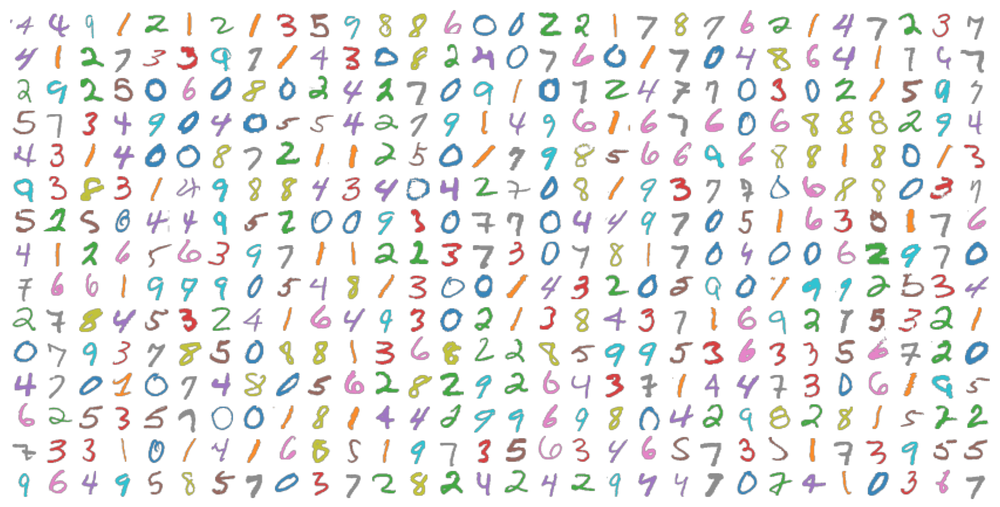

In [4]:
data, target = fetch_openml('mnist_784', version=1, return_X_y=True)
data = data.astype('float32')
target = target.astype('uint8')

fig, ax = plt.subplots(figsize=(16,8))

size = 28
dim = (15,30)
n = dim[0] * dim[1]
rnd = np.random.permutation(data.shape[0])

img = np.zeros((size * dim[0], size * dim[1], 4),dtype='uint8')

for d, t, i in zip(data[rnd[:n]], target[rnd[:n]], range(n)):
  ix, iy = divmod(i, dim[1])
  img[ix*size:(ix+1)*size,iy*size:(iy+1)*size,:] = colorize(d.reshape(size,size), colors[t], 0.9)

ax.imshow(img)
ax.set_axis_off()
plt.show()

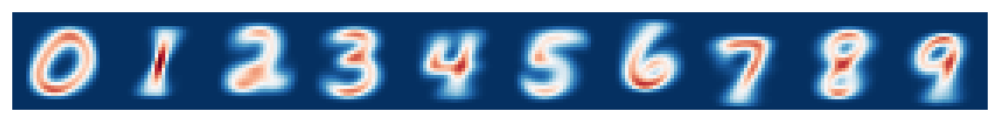

In [5]:
# 각 클래스별 문자의 이미지를 평균화하여, 표시
fig, ax = plt.subplots(figsize=(10,3))

img = np.zeros((28,28*10))

for i in range(0,10):
  img[:,i*28:(i+1)*28] = np.mean(data[np.argwhere(target==i)],axis=0).reshape((28,28))

ax.imshow(img, cmap='RdBu_r')
ax.set_axis_off()
plt.show()

#### t-SNE을 이용하여 2차원으로 매핑

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2500 samples in 0.004s...
[t-SNE] Computed neighbors for 2500 samples in 0.468s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2500
[t-SNE] Computed conditional probabilities for sample 2000 / 2500
[t-SNE] Computed conditional probabilities for sample 2500 / 2500
[t-SNE] Mean sigma: 2.468671
[t-SNE] Computed conditional probabilities in 0.110s
[t-SNE] Iteration 50: error = 74.9300766, gradient norm = 0.0000091 (50 iterations in 0.518s)
[t-SNE] Iteration 100: error = 74.9296722, gradient norm = 0.0011887 (50 iterations in 0.485s)
[t-SNE] Iteration 150: error = 74.3150177, gradient norm = 0.0111878 (50 iterations in 0.627s)
[t-SNE] Iteration 200: error = 73.9498749, gradient norm = 0.0003383 (50 iterations in 0.475s)
[t-SNE] Iteration 250: error = 73.9465332, gradient norm = 0.0003368 (50 iterations in 0.463s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.946533
[t-SNE] Iteration 300: err

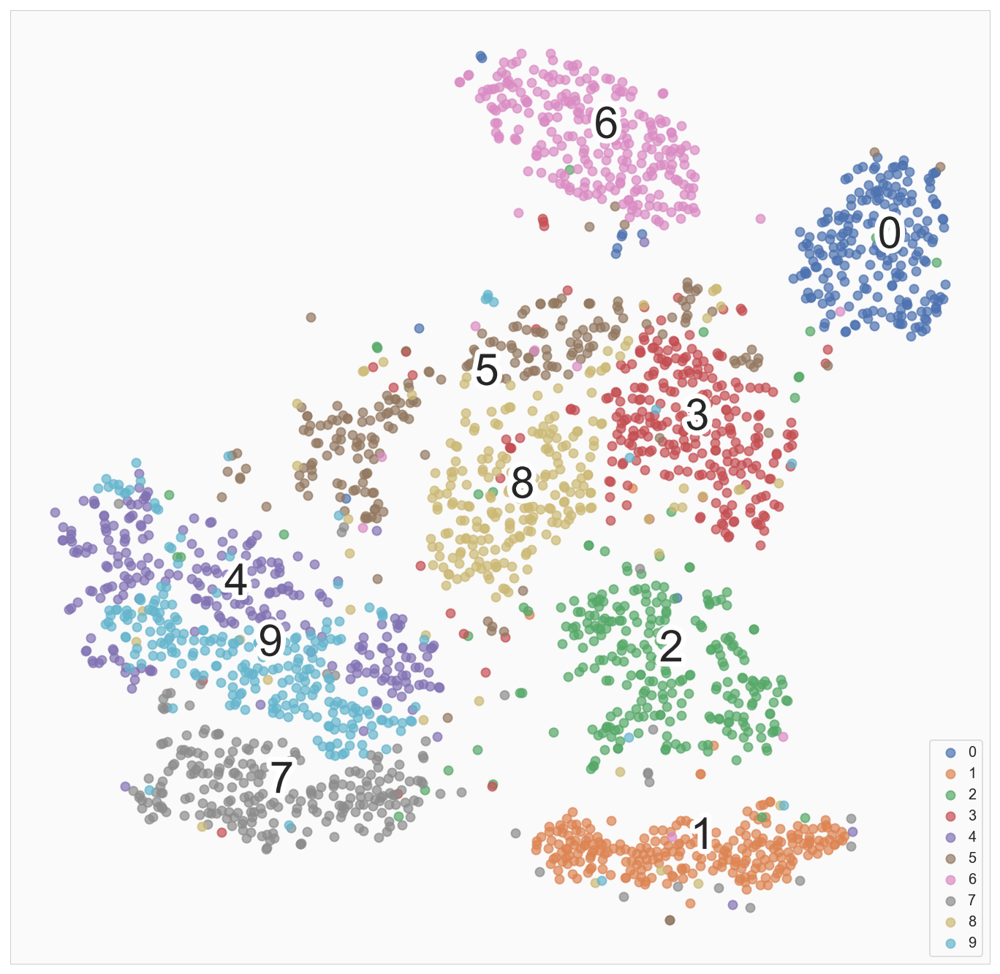

In [6]:
# t-SNE으로 스타일의 특징을 검출하고, 평면으로 매핑
size = 50
n = size * size
x_data, y_data = shuffle(data, target, n_samples=n)
x_pca = PCA(n_components=50).fit_transform(x_data/255)
embeddings = TSNE(perplexity=50, random_state=24680, verbose=2).fit_transform(x_pca)
embeddings = minmax_scale(embeddings)

fig, ax = plt.subplots(figsize=(12,12))

for i in range(10):
  ax.scatter(embeddings[y_data==i,0],embeddings[y_data==i,1],cmap='tab10',marker='o',alpha=0.7,label=i)
  x_,y_ = np.median(embeddings[y_data==i,:],axis=0)
  txt = ax.text(x_,y_,str(i),fontsize=30)
  txt.set_path_effects([
    patheffects.Stroke(linewidth=7, foreground="w"),
    patheffects.Normal()
  ])

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])
ax.legend(loc='lower right')

plt.show()

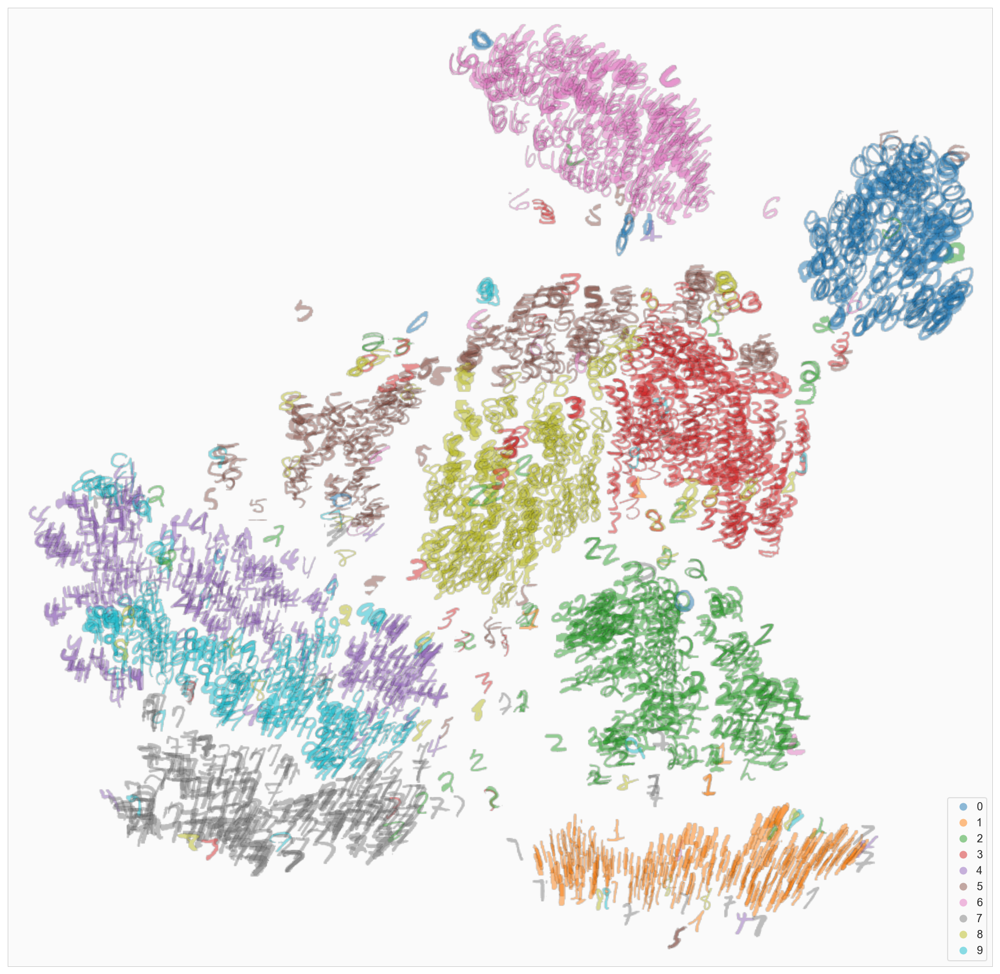

In [7]:
# 데이터 포인트 이미지
fig, ax = plt.subplots(figsize=(16,16))

source = zip(embeddings, x_data.reshape((-1,28,28)), y_data)

for pos, d, i in source:
  img = colorize(d, colors[i], 0.5)
  ab = offsetbox.AnnotationBbox(offsetbox.OffsetImage(img),0.03 + pos * 0.94,frameon=False)
  ax.add_artist(ab)

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])

handles = [mlines.Line2D([0], [0], label=i,
                         linewidth=0, marker='o', alpha=0.5,
                         markersize=7,markerfacecolor=colors[i],markeredgewidth=0)
           for i in range(10)]
ax.legend(loc='lower right',handles=handles)
plt.show()

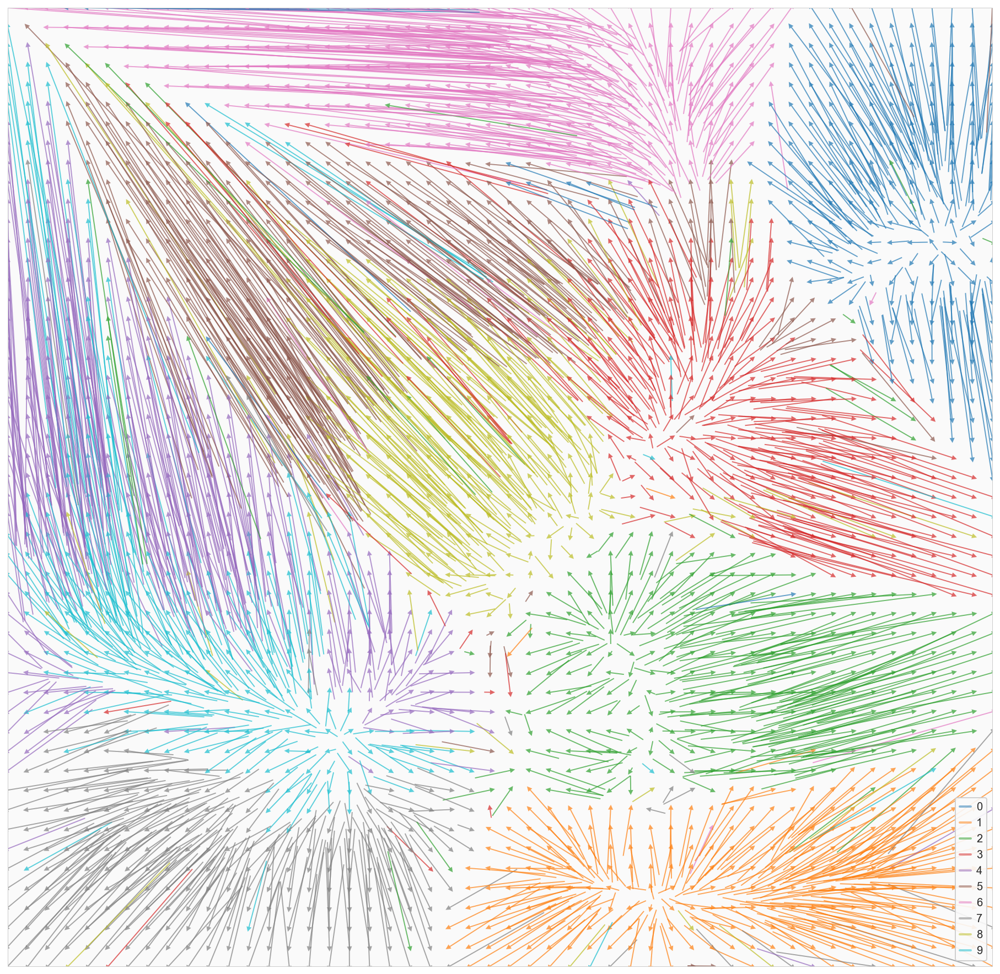

In [8]:
# src-d/japjv를 이용하여 숫자는 그리드에 배열
# 각 데이터 포인트의 이동방향 확인
grid = np.dstack(np.meshgrid(np.linspace(0, 1, size), np.linspace(0, 1, size))).reshape(-1, 2)
cost = cdist(grid, embeddings, 'sqeuclidean').astype('float32')
cost *= 1e7 / cost.max()

_, col_asses, _ = lapjv(cost)
grid_jv = grid[col_asses]

fig, ax = plt.subplots(figsize=(16, 16))

for start, end, i in zip(embeddings, grid_jv, y_data):
  plt.arrow(start[0], start[1], end[0] - start[0], end[1] - start[1],
            color=colors[i], linewidth=0.05,
            head_length=0.005, head_width=0.005, alpha=0.7)

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])
handles = [mlines.Line2D([0], [0], label=i, linewidth=2, alpha=0.5,markersize=7,color=colors[i])
           for i in range(10)]
ax.legend(loc='lower right',handles=handles,framealpha=0.9,handletextpad=0.5,handlelength=1.0)

plt.show()

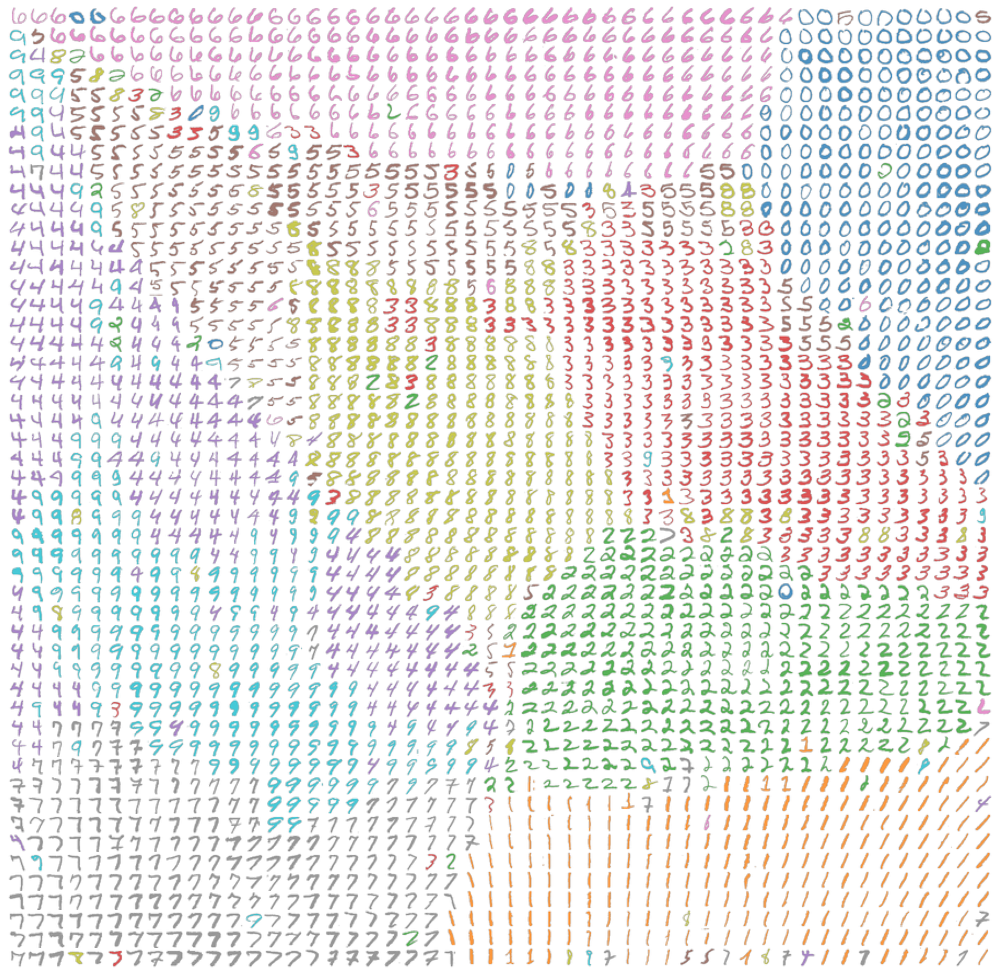

In [9]:
# 숫자이미지 표시
fig, ax = plt.subplots(figsize=(16,16))

for pos, d, i in zip(grid_jv, x_data.reshape((-1,28,28)), y_data):
  img = Image.fromarray(colorize(d, colors[i], 0.8), 'RGBA').resize((20, 20), Image.ANTIALIAS)
  ab = offsetbox.AnnotationBbox(offsetbox.OffsetImage(img),0.01+pos*0.98,frameon=False)
  ax.add_artist(ab)

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])
ax.set_axis_off()

plt.show()

#### 단일 숫자만 시각화

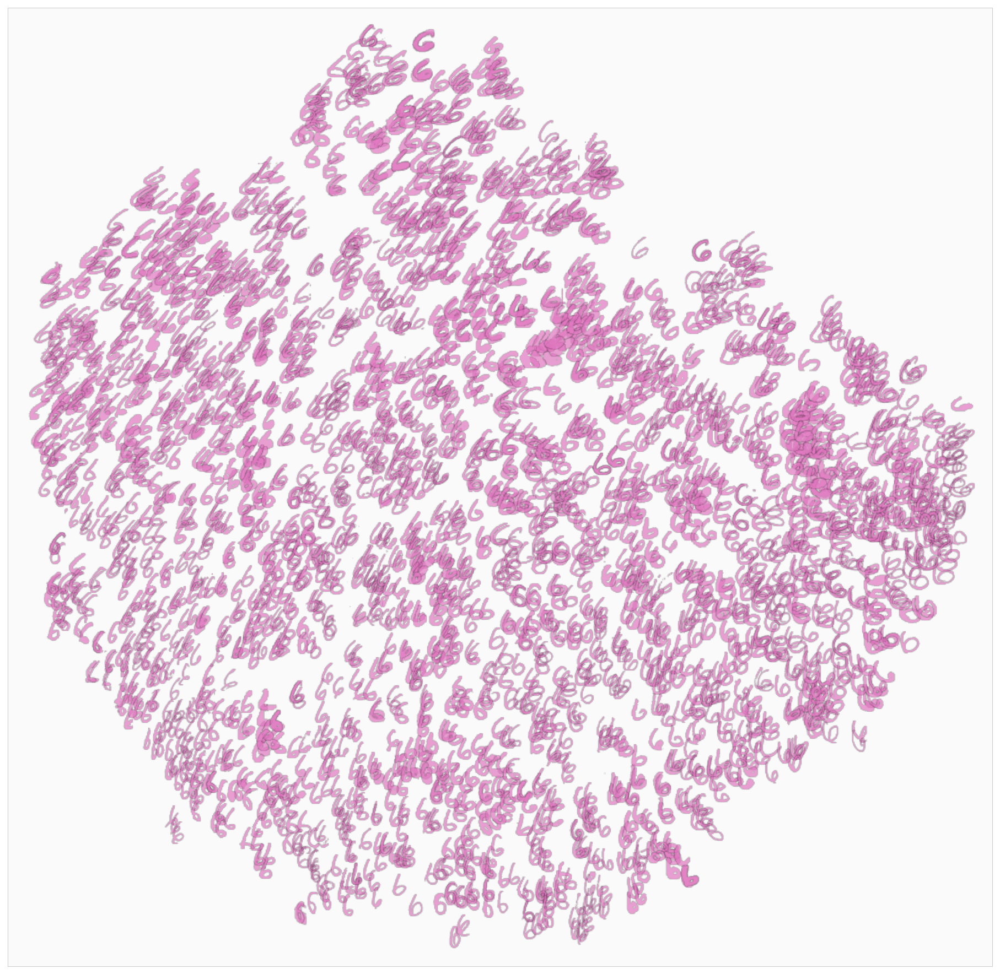

In [10]:
num = 6
size = 50
n = size ** 2

x_data_n, y_data_n = shuffle(data[target==num], target[target==num], n_samples=n)
x_pca_n = PCA(n_components=50).fit_transform(x_data_n/255)
embeddings_n = TSNE(perplexity=50, random_state=24680, verbose=0).fit_transform(x_pca_n)
embeddings_n = minmax_scale(embeddings_n)
fig, ax = plt.subplots(figsize=(16,16))

for pos, d in zip(embeddings_n, x_data_n.reshape((-1,28,28))):
  img = colorize(d, colors[num], 0.7)
  ab = offsetbox.AnnotationBbox(offsetbox.OffsetImage(img),0.03 + pos * 0.94,frameon=False)
  ax.add_artist(ab)
  ax.xaxis.set_ticks([])
  ax.yaxis.set_ticks([])

plt.show()

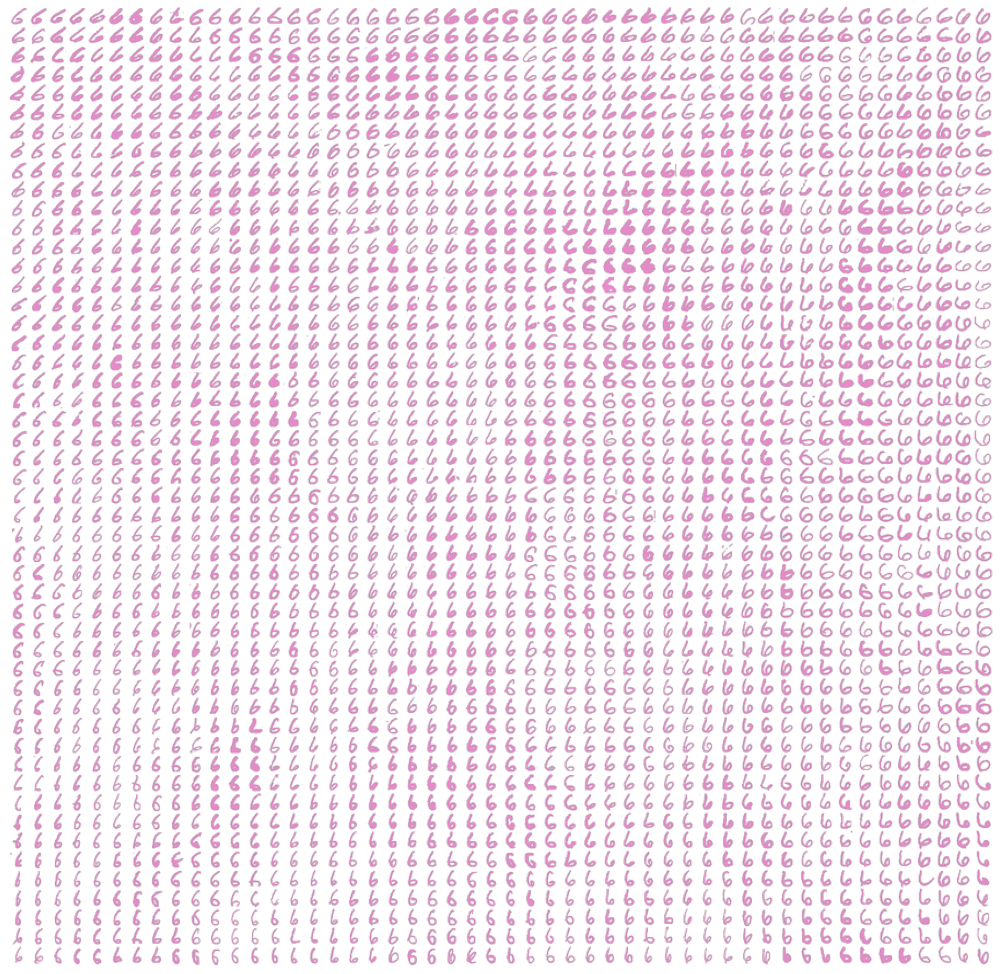

In [11]:
grid_n = np.dstack(np.meshgrid(np.linspace(0, 1, size), np.linspace(0, 1, size))).reshape(-1, 2)
cost_n = cdist(grid_n, embeddings_n, 'sqeuclidean').astype('float32')
cost_n *= 1e7 / cost_n.max()
_, col_asses_n, _ = lapjv(cost_n)
grid_jv_n = grid_n[col_asses_n]

fig, ax = plt.subplots(figsize=(16,16))

for pos, d in zip(grid_jv_n, x_data_n.reshape((-1,28,28))):
  img = colorize(d, colors[num], 0.85)
  img = Image.fromarray(img,'RGBA').resize((20, 20), Image.ANTIALIAS)
  ab = offsetbox.AnnotationBbox(offsetbox.OffsetImage(img),0.01 + pos * 0.98,frameon=False)
  ax.add_artist(ab)

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])
ax.set_axis_off()

plt.show()